In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
sys.path.append(os.path.realpath('..'))

In [3]:
import numpy as np
import plotly.express as ex
import plotly.graph_objects as go
import pandas as pd

from numpy import exp

from tracking.motion import ConstantVelocityModel, constant_velocity_models
from tracking.target import ConstantAccelerationTarget, ConstantVelocityTarget, SinusTarget, SingerTarget
from tracking.kalman import kalman_pv
from tracking.evaluation import monte_carlo, rmse, execute, state_residuals

from tracking.plot import boxplot_rmse, aggregated_errors, plot_aggregated_errors, plot_error_band
from tracking.util import to_df

In [4]:
from scipy import stats

# Constant-Velocity Model

## Constant-Velocity Target

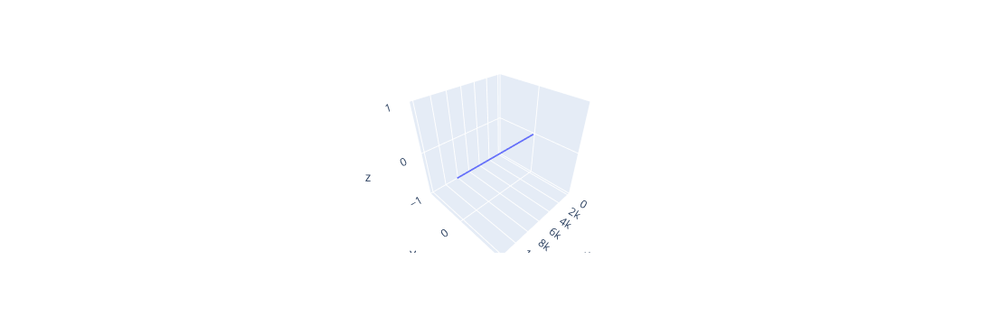

In [5]:
target = ConstantVelocityTarget()

fig = ex.scatter_3d(target.true_states_df(), x='x', y='y', z='z')
fig.update_traces(marker_size = 1)
fig

In [43]:
motion  = constant_velocity_models(.1 ,.5, 1, 2, 5, 10, 20)
z_sigma = [.87, 8.72, 87.2]
results = monte_carlo(target, motion, z_sigma)

### Sample run

Let's take a sample run and inspect it a bit closer. This run was generated with a Constant Velocity (`target = cv`) target, a Constant Velocity motion model with process noise intensity $0.1$ (`motion = cv_0.1`), assumed measurement noise standard deviation $0.87$ (`R = 0.87`), actual measurement noise standard deviation $0.87$ (`z_sigma = 0.87`), and random generator seed set to $0$. 

In [7]:
r = results.select(z_sigma=.87)[0]
r

EvaluationResult {'target': 'cv', 'motion': 'cv_0.1', 'z_sigma': 0.87, 'seed': 0, 'R': 0.7569}

Next, we plot residuals of the Kalman Filter state in time. As expected, after the initial period of larger errors in the `x` dimension, when Kalman Filter converges on the true velocity, residuals seem to oscilate around zero.

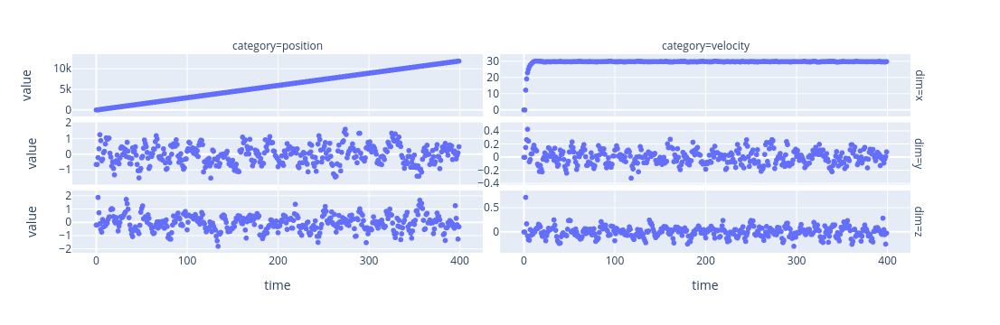

In [8]:
df = r.x_hat_df.melt(id_vars=['time'], var_name='dim')
df['category'] = df.dim.apply(lambda x: 'velocity' if x.startswith('v') else 'position')
df['dim'] = df.dim.apply(lambda x: x[1:] if x.startswith('v') else x)

fig = ex.scatter(df, x='time', y='value', facet_col='category', facet_row='dim')
fig.update_yaxes(matches=None, showticklabels=True)
fig

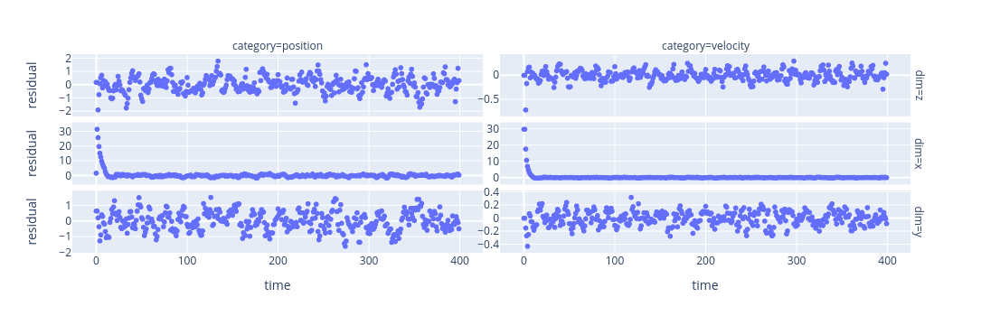

In [9]:
err = state_residuals(r)
fig = ex.scatter(err, x='time', y='residual', facet_col='category', facet_row='dim')
fig.update_yaxes(matches=None, showticklabels=True)
fig

We confirm that by plotting the histogram of each error.

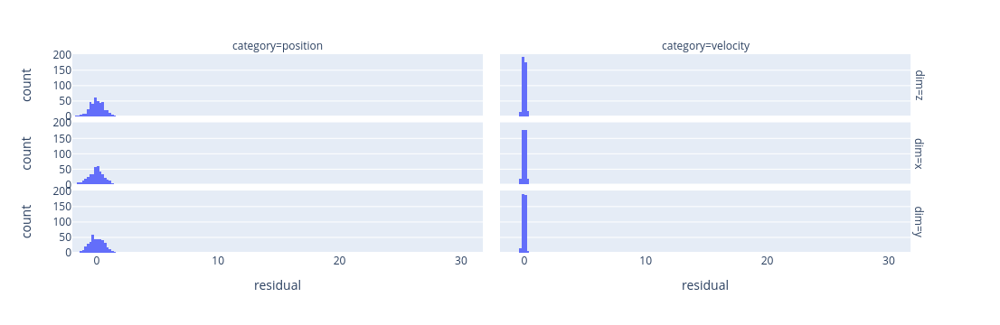

In [10]:
ex.histogram(err, x='residual', facet_col='category', facet_row='dim')

Finally, we get rid of the outliers from the initial period.

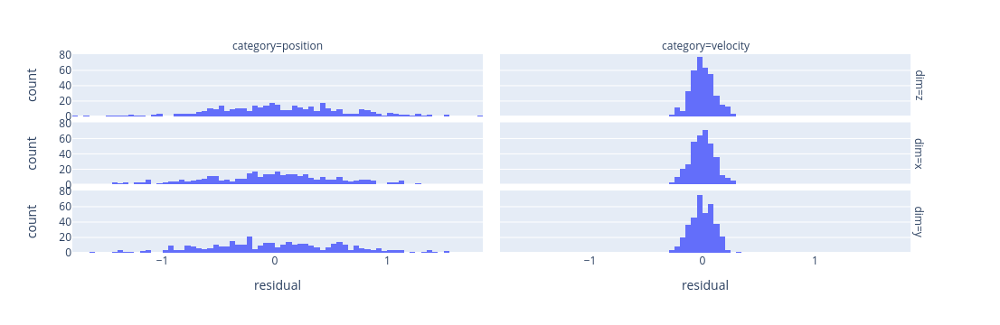

In [11]:
ex.histogram(err.query('time > 30'), x='residual', facet_col='category', facet_row='dim')

Let's see if those shapes will look better if let the algorithm run for more than 400 iterations.

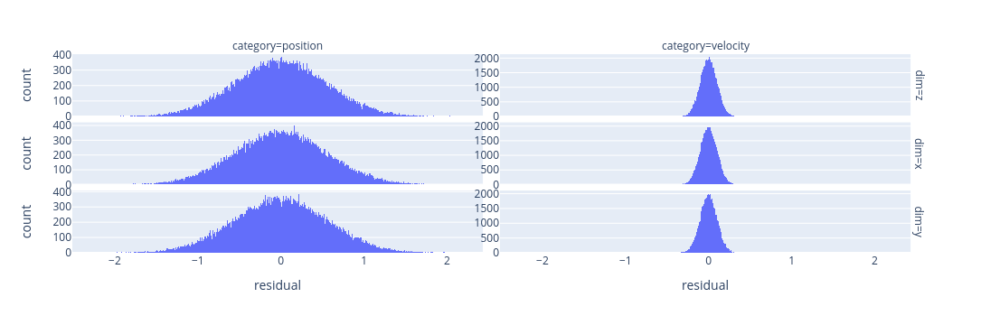

In [12]:
err = state_residuals(execute(r.copy(n=50000)))
fig = ex.histogram(err.query('time > 30'), x='residual', facet_col='category', facet_row='dim')
fig.update_yaxes(matches=None, showticklabels=True)
fig

In [13]:
trace = []
for name, group in err.query('time > 500').groupby(by=['category', 'dim']):
    #res = stats.goodness_of_fit(stats.norm, group.residual, statistic='ad', random_state=np.random.default_rng())
    #trace.append(name + (res.pvalue, round(res.fit_result.params.loc, 5), round(res.fit_result.params.scale, 5)))

    loc, scale = np.mean(group.residual), np.std(group.residual, ddof=1)
    cdf = stats.norm(loc, scale).cdf
    res = stats.ks_1samp(group.residual, cdf)

    trace.append(name + (res.pvalue, round(loc, 5), round(scale, 5)))
    
to_df(trace, columns=['category', 'dim', 'pvalue', 'loc', 'scale'])

,category,dim,pvalue,loc,scale
0,position,x,0.6232034504572606,-0.0004,0.56593
1,position,y,0.9191682273500751,-0.00307,0.56585
2,position,z,0.9297972607942304,-0.00458,0.55846
3,velocity,x,0.7708753230472224,-1e-05,0.10152
4,velocity,y,0.6612577072548582,-0.0,0.10161
5,velocity,z,0.8384028747082041,0.0,0.10053


From the above we see that all dimensions of the Kalman Filter state are distributed normally, with zero mean and standard deviation equal across position and velocity elements.

## Verify measurements

In [56]:
x = execute(results[0].copy(n=10000))
x.z_sigma, np.sqrt(x.R), np.std((x.z - x.truth[:,:3]), axis=0)

(0.87, 0.87, array([0.87117195, 0.86860256, 0.86040345]))

### RMSE

Root mean squared error (RMSE) calculates the L2 norm of the difference between the estimated and the true position and velocity.

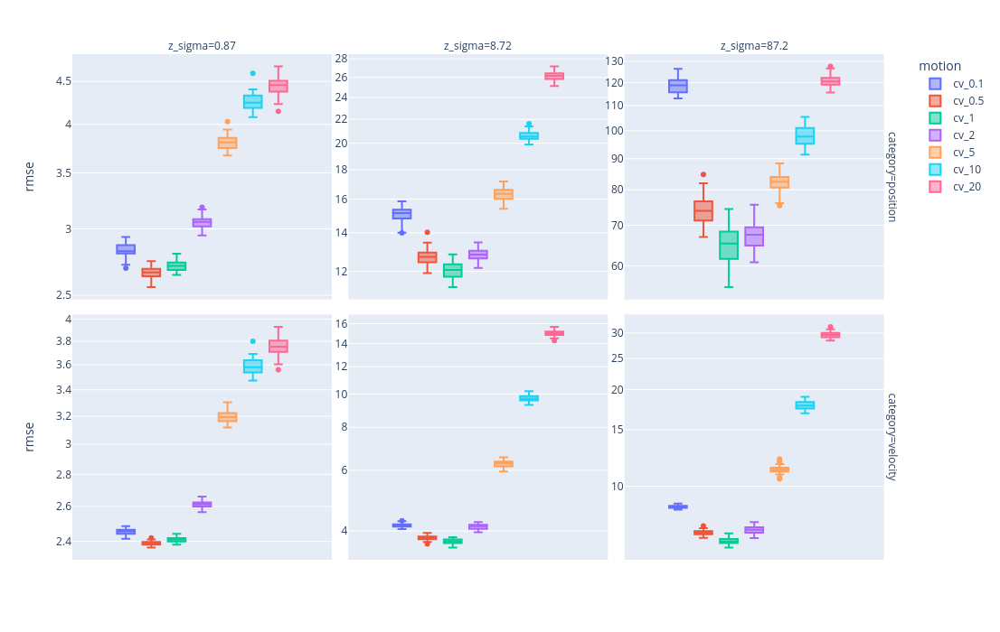

In [14]:
data = rmse(results)

fig=ex.box(data, y='rmse', color='motion', facet_col='z_sigma', facet_row='category', log_y=True)
fig.update_xaxes(type='category')
fig.update_yaxes(matches=None, showticklabels=True)
fig.update_layout(height=700)
fig

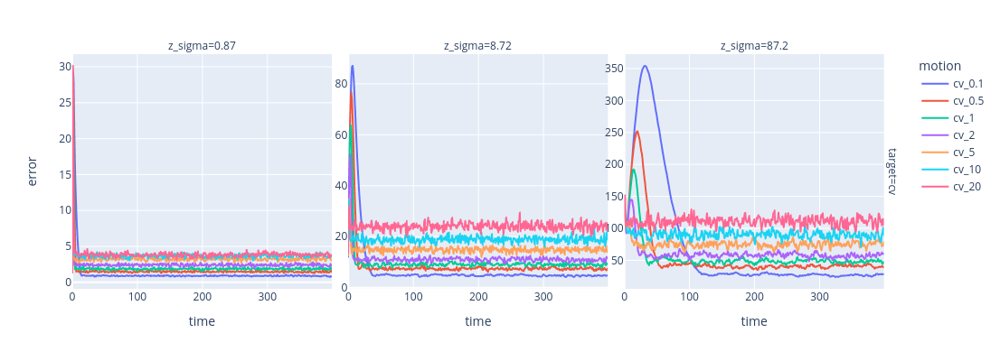

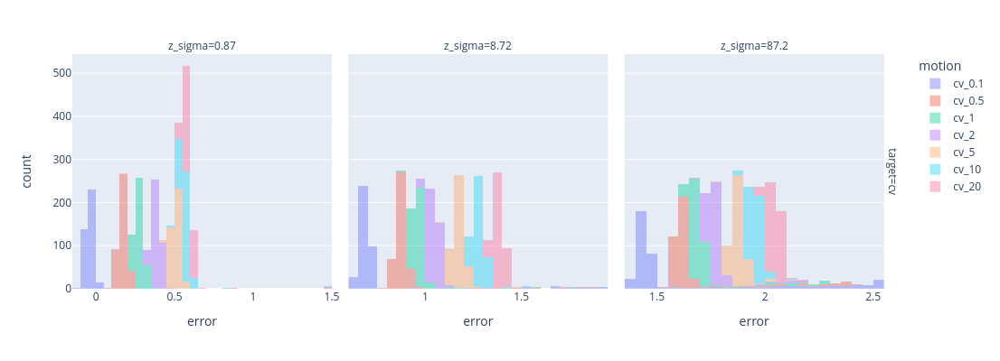

In [15]:
plot_aggregated_errors(results).update_layout(height=400)

## Constant-Acceleration Target

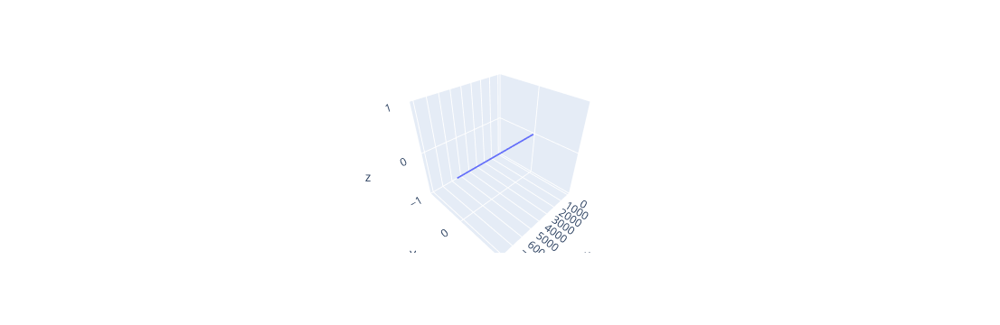

In [16]:
target = ConstantAccelerationTarget()

fig = ex.scatter_3d(target.true_states_df(), x='x', y='y', z='z')
fig.update_traces(marker_size = 1)
fig

In [17]:
targets = [ConstantAccelerationTarget(.1), ConstantAccelerationTarget(.5), ConstantAccelerationTarget(2)]
motion  = constant_velocity_models(.1 ,.5, 1, 2, 5, 10, 20)
z_sigma = [.87, 8.72, 87.2]
results = monte_carlo(targets, motion, z_sigma)

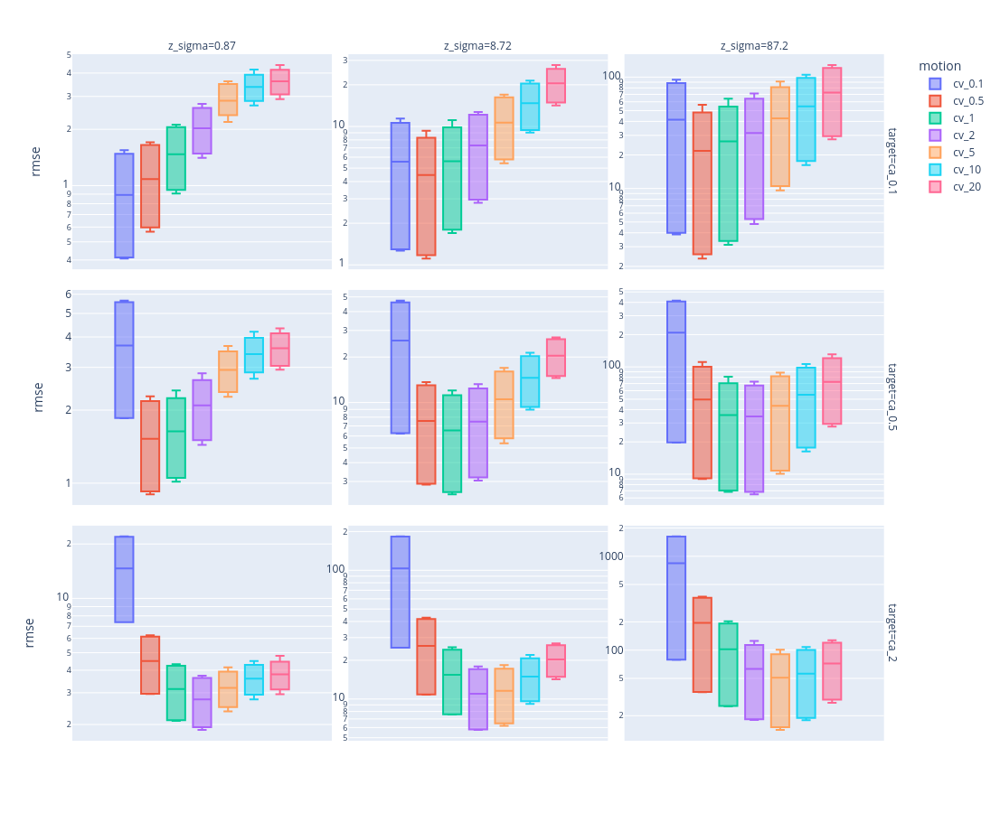

In [18]:
data = rmse(results)

fig=ex.box(data, y='rmse', color='motion', facet_col='z_sigma', facet_row='target', log_y=True)
fig.update_xaxes(type='category')
fig.update_yaxes(matches=None, showticklabels=True)
fig.update_layout(width=1100, height=900)
fig

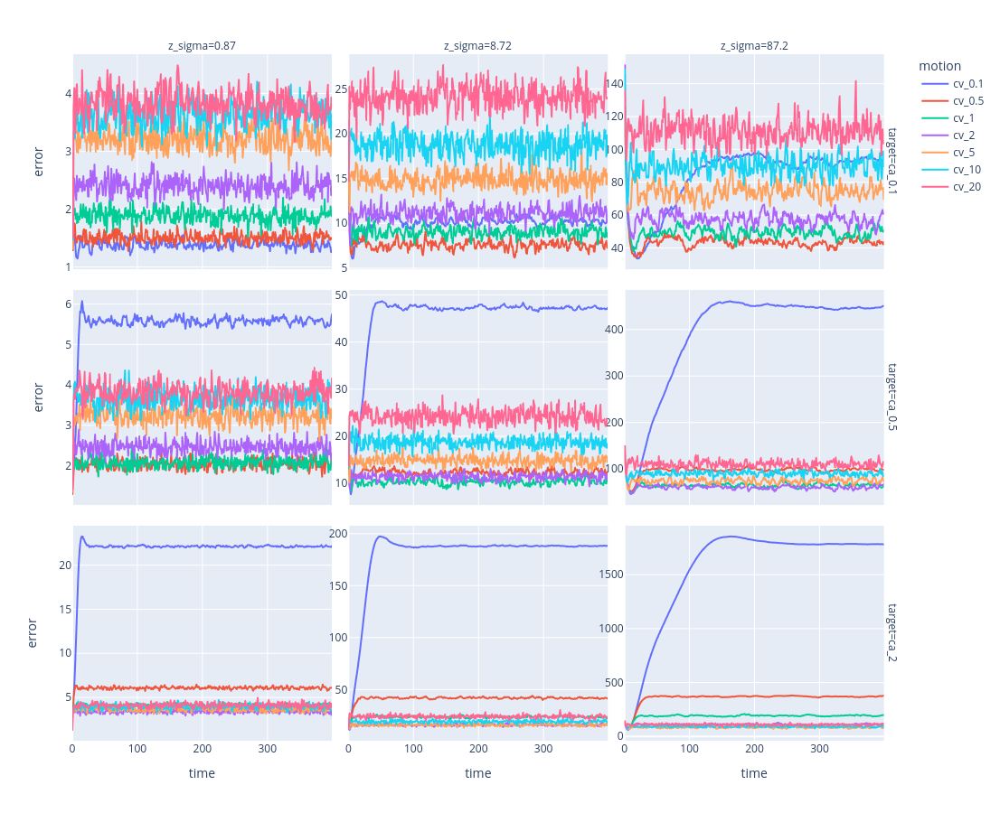

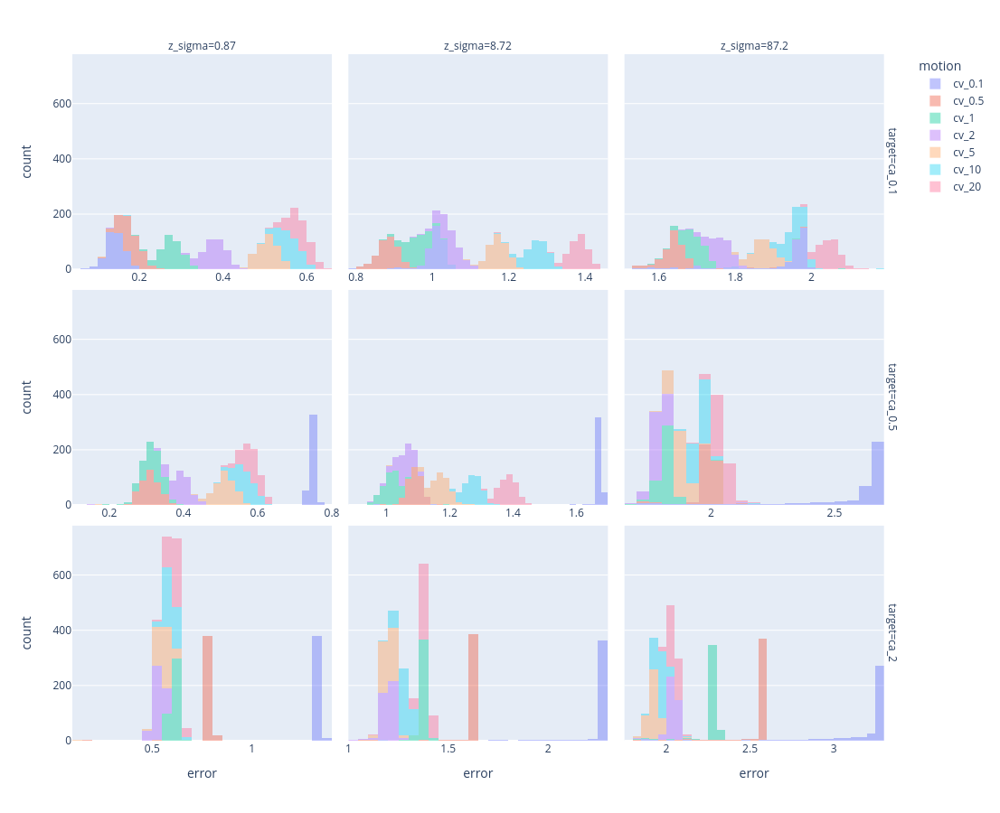

In [19]:
plot_aggregated_errors(results)

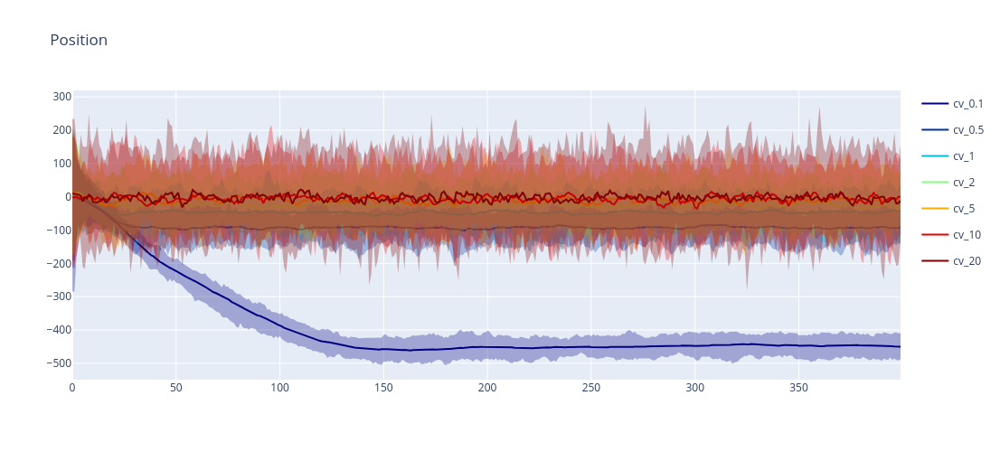

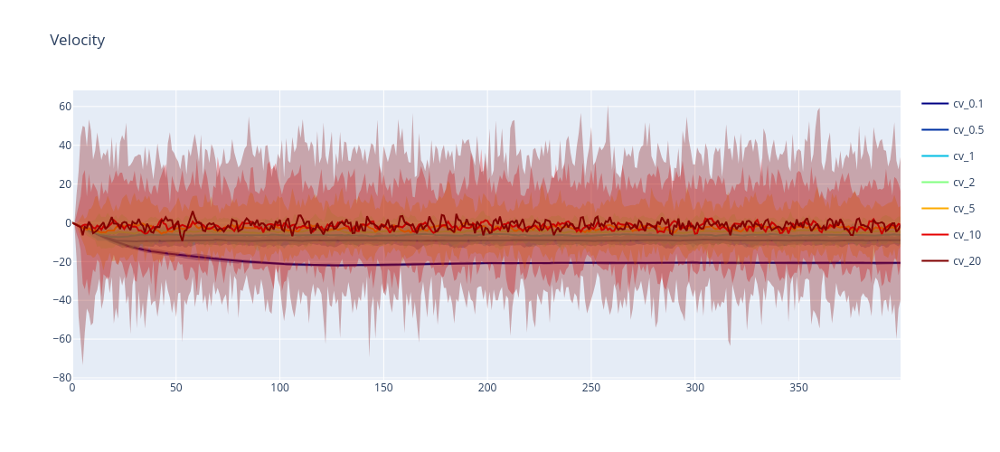

In [20]:
sel = results.select(target='ca_0.5', z_sigma='87.2')
plot_error_band(sel).update_layout(height=500)

In [21]:
x = results[0].truth[:,0]
data = np.array((np.arange(400), results[0].K[:,0,0], results[0].z[:,0]-x, results[0].x_hat[:,0]-x)).T
data = to_df(data, columns=['t', 'K', 'z', 'x_hat'])

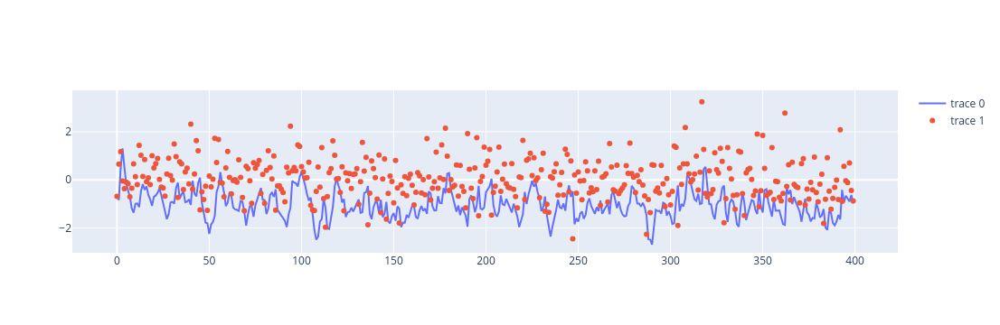

In [22]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['t'], y=data['x_hat'], mode='lines'))
fig.add_trace(go.Scatter(x=data['t'], y=data['z'], mode='markers'))
fig

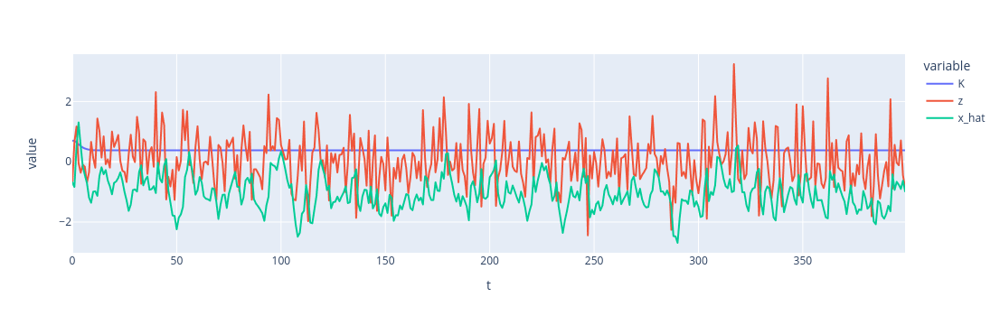

In [23]:
ex.line(data.melt(id_vars=['t']), x='t', y='value', color='variable')

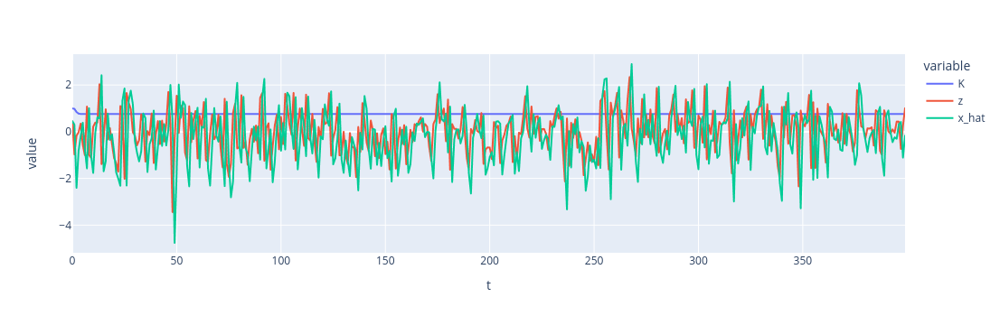

In [24]:
r = execute(results[0].copy(R=.01))

x = r.truth[:,0]
data = np.array((np.arange(400), r.K[:,0,0], r.z[:,0]-x, r.x_hat[:,0]-x)).T
data = to_df(data, columns=['t', 'K', 'z', 'x_hat'])

ex.line(data.melt(id_vars=['t']), x='t', y='value', color='variable')

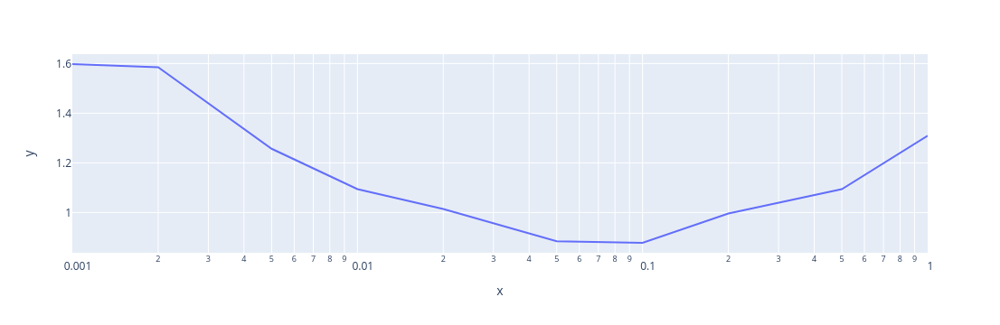

In [25]:
err = []
Rs = [.001, .002, .005, .01, .02, .05, .1, .2, .5, .7, 1]

for R in Rs:
    r = execute(results[0].copy(R=R))
    e = np.sqrt(np.power(np.array(r.x_hat[:,0] - r.truth[:,0]), 2).mean())
    err.append(e)

ex.line(x=Rs, y=err, log_x=True)

In [26]:
a = .5
results = monte_carlo(ConstantAccelerationTarget(a), ConstantVelocityModel(.1), 87.2, seeds=range(500), n=400)

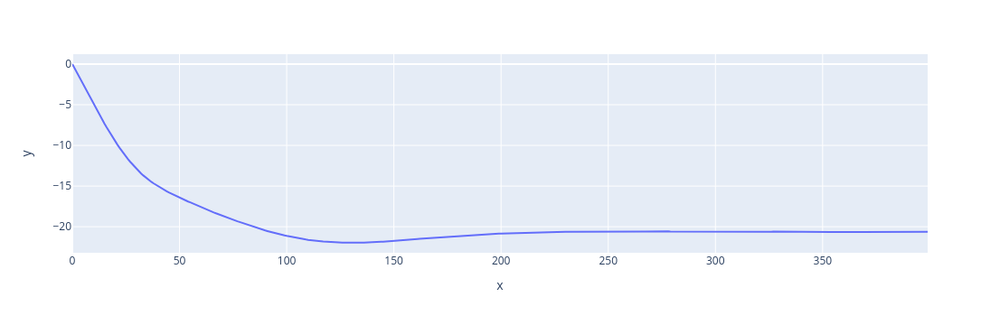

In [27]:
d = np.array([r.x_hat[:,3] - r.truth[:,3] for r in results]).T
ex.line(y=d.mean(axis=1))

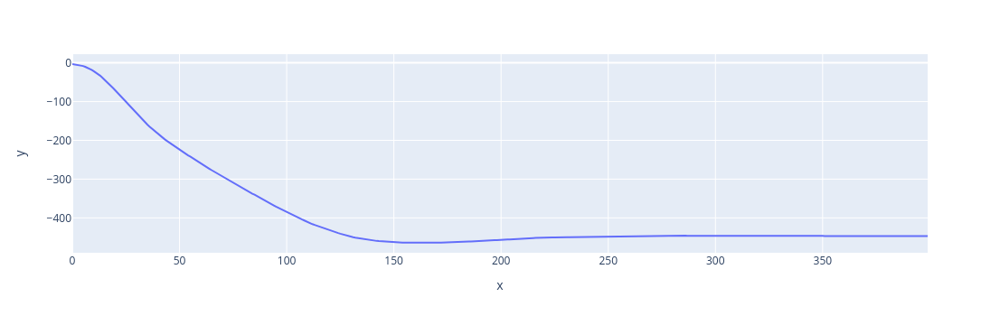

In [28]:
d = np.array([r.x_hat[:,0] - r.truth[:,0] for r in results]).T
ex.line(y=d.mean(axis=1))

In [29]:
Kx = results[0].K[-1,0,0]
Kv = results[0].K[-1,3,0]
Kx, Kv

(0.04676261551988992, 0.0011196545460642083)

In [30]:
# dx, dv
a/Kv, a*((Kx+Kv)/Kv - .5)

(446.5663107943356, 21.132608695811186)

In [31]:
a = .25
results = monte_carlo(ConstantAccelerationTarget(a), ConstantVelocityModel(.5), 1, seeds=range(5000), n=200)

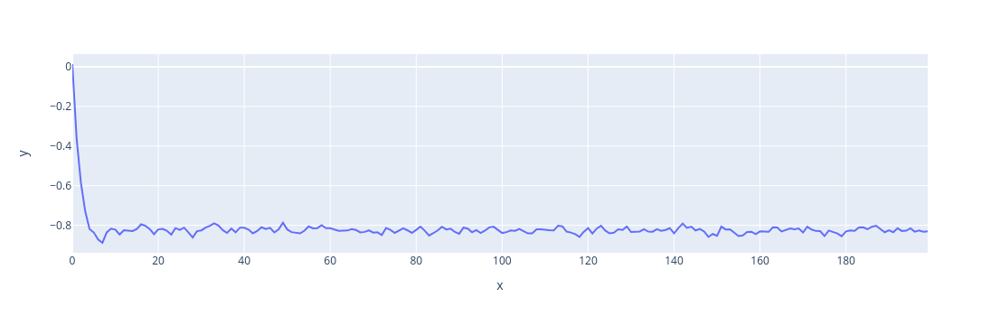

In [32]:
dx = np.array([r.x_hat[:,0] - r.truth[:,0] for r in results]).T.mean(axis=1)
ex.line(y=dx)

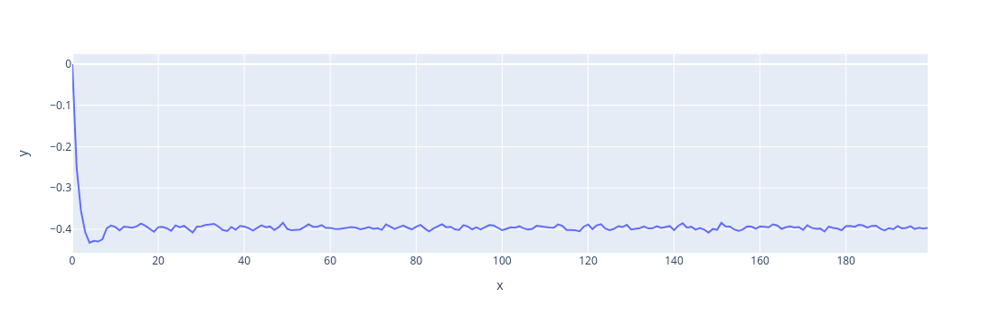

In [33]:
dy = np.array([r.x_hat[:,3] - r.truth[:,3] for r in results]).T.mean(axis=1)
ex.line(y=dy)

In [34]:
Kx = results[0].K[-1,0,0]
Kv = results[0].K[-1,3,0]
Kx, Kv

(0.6320850016101968, 0.30327998548775165)

In [35]:
# dx, dv
a/Kv, a * (Kx/Kv - .5)

(0.8243207991385787, 0.3960408136508272)

In [36]:
dx[100:].mean(), dy[100:].mean()

(-0.8267998027415204, -0.39613661231147573)

In [37]:
As = [.1, .2, .5, 1, 2]
trace = []

for a in As:
    results = monte_carlo(ConstantAccelerationTarget(a), ConstantVelocityModel(.5), 1, seeds=range(10000), n=600)
    Kx = results[0].K[-1,0,0]
    Kv = results[0].K[-1,3,0]

    dx = np.array([r.x_hat[:,0] - r.truth[:,0] for r in results]).T.mean(axis=1)
    dy = np.array([r.x_hat[:,3] - r.truth[:,3] for r in results]).T.mean(axis=1)
    
    trace.append((Kx, Kv, a/Kv, a * (Kx/Kv - .5), dx[100:].mean(), dy[100:].mean()))

KeyboardInterrupt: 

In [ ]:
to_df(np.array(trace))

In [ ]:
dy = np.array([r.x_hat[:,3] - r.truth[:,3] for r in results]).T.mean(axis=1)
ex.line(y=dy)